In [1]:
!pip install --upgrade pip
!pip install imutils

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 33.9 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.1.2
    Uninstalling pip-23.1.2:
      Successfully uninstalled pip-23.1.2
  Preparing metadata (setup.py) ... - \ done
  Created wheel for imutils: filename=imutils-0.5.4-py3-none-any.whl size=25859 sha256=7a34166efe3fd962f9841bd939aa09a33cd4332b0f2f365fb61c970b72cad438
  Stored in directory: /root/.cache/pip/wheels/85/cf/3a/e265e975a1e7c7e54eb3692d6aa4e2e7d6a3945d29da46f2d7
Successfully built imutils


In [2]:
# Import Libraries
# Warning
import warnings
warnings.filterwarnings("ignore")

# Main
import os
import glob
import cv2
import numpy as np
import pandas as pd
import gc
import string
import time
import random
import imutils
from PIL import Image
from tqdm import tqdm
tqdm.pandas()

# Visualization
import matplotlib
import matplotlib.pyplot as plt
!pip install plotly
import plotly
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from sklearn.manifold import TSNE

# Model
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array, array_to_img
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Flatten, Dropout
from keras.models import load_model, Model
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint, EarlyStopping
import seaborn as sns
from sklearn.metrics import confusion_matrix, roc_curve, roc_auc_score, precision_recall_fscore_support
from sklearn.preprocessing import label_binarize
from itertools import cycle

In [3]:
# setting up hyperparameters
import time

# Get the current timestamp
current_time = int(time.time())

# Set the seed using the current timestamp
seed = current_time

# Set the paths and parameters
#TRAIN_DIR = "/kaggle/input/american-sign-language/ASL_Dataset/Train"
#IMAGE_SIZE = (64, 64)
#BATCH_SIZE = 64
#SEED = seed

In [4]:
# Labels
TRAIN_PATH = "/kaggle/input/asl-alphabet/asl_alphabet_train/asl_alphabet_train"
#TEST_PATH = "/kaggle/input/asl-alphabet-test"
#labels = list(string.ascii_uppercase) + ["del", "nothing", "space"]
# labels = list(string.ascii_uppercase) + ["Nothing", "Space"]
labels = list(string.ascii_uppercase) 

In [5]:
# Function to sample and display images for each label
def sample_images(labels):
    fig, axs = plt.subplots(len(labels), 9, figsize=(12, 13))

    for i, label in enumerate(labels):
        axs[i, 0].text(0.5, 0.5, label, ha='center', va='center', fontsize=8)
        axs[i, 0].axis('off')

        label_path = os.path.join(TRAIN_PATH, label)
        list_files = os.listdir(label_path)

        for j in range(8):
            img_label = cv2.imread(os.path.join(label_path, list_files[j]))
            img_label = cv2.cvtColor(img_label, cv2.COLOR_BGR2RGB)
            axs[i, j+1].imshow(img_label)
            axs[i, j+1].axis("off")

    plt.suptitle("Sample Images in ASL Alphabet Dataset", x=0.55, y=0.92)
    plt.show()

In [6]:
# Create Metadata
list_path = []
list_labels = []
for label in labels:
    label_path = os.path.join(TRAIN_PATH, label, "*")
    image_files = glob.glob(label_path)
    sign_label = [label] * len(image_files)
    list_path.extend(image_files)
    list_labels.extend(sign_label)

metadata = pd.DataFrame({
    "image_path": list_path,
    "label": list_labels
})

In [7]:
from sklearn.utils import resample
from sklearn.model_selection import train_test_split

# Define the desired number of samples
desired_samples = 50000

# Randomly sample the dataset to the desired number of samples
downsampled_data = metadata.sample(n=desired_samples, random_state=2023)

# Split the downsampled dataset into Train, Validation, and Test sets
train_data, remaining_data = train_test_split(downsampled_data, train_size=0.60, random_state=2023)
val_data, test_data = train_test_split(remaining_data, train_size=0.65, random_state=2023)

# Verify the sizes of the splits
print("Train Data Size:", len(train_data))
print("Validation Data Size:", len(val_data))
print("Test Data Size:", len(test_data))

# Create DataFrames for train, validation, and test sets
data_train = pd.DataFrame(train_data, columns=["image_path", "label"])
data_val = pd.DataFrame(val_data, columns=["image_path", "label"])
data_test = pd.DataFrame(test_data, columns=["image_path", "label"])


Train Data Size: 30000
Validation Data Size: 13000
Test Data Size: 7000


In [8]:
# Data Augmentation (Just Rescale)
datagen = ImageDataGenerator(rescale=1/255.)
train_generator = datagen.flow_from_dataframe(
    train_data,
    directory="./",
    x_col="image_path",
    y_col="label",
    class_mode="categorical",
    batch_size=64,
    target_size=(64, 64),
)

val_generator = datagen.flow_from_dataframe(
    val_data,
    directory="./",
    x_col="image_path",
    y_col="label",
    class_mode="categorical",
    batch_size=64,
    target_size=(64, 64),
)
test_generator = datagen.flow_from_dataframe(
    test_data,
    directory="./",
    x_col="image_path",
    y_col="label",
    class_mode="categorical",
    batch_size=1,
    target_size=(64, 64),
    shuffle=False
)

Found 30000 validated image filenames belonging to 26 classes.
Found 13000 validated image filenames belonging to 26 classes.
Found 7000 validated image filenames belonging to 26 classes.


In [9]:
# Load VGG16 model and modify for ASL recognition
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(64, 64, 3))
for layer in base_model.layers:
    layer.trainable = False

x = base_model.output
x = Flatten()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(26, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)

# Display model summary
model.summary()

58889256/58889256 [==============================] - 0s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 32, 32, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 32, 32, 128)       147584    
                                                              

In [10]:
# Compile the model
model.compile(optimizer=Adam(learning_rate=0.00001), loss='categorical_crossentropy', metrics=['accuracy'])

In [11]:
# Define callbacks
checkpoint = ModelCheckpoint('asl_vgg16_best_weights.h5', save_best_only=True, monitor='val_accuracy', mode='max')

In [12]:
# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // 64,
    epochs=50,
    validation_data=val_generator,
    validation_steps=val_generator.samples // 64,
    callbacks=[checkpoint]
)

Epoch 1/50
468/468 [==============================] - 253s 523ms/step - loss: 3.3925 - accuracy: 0.0524 - val_loss: 3.1086 - val_accuracy: 0.2316
Epoch 2/50
468/468 [==============================] - 66s 141ms/step - loss: 3.1488 - accuracy: 0.0987 - val_loss: 2.9551 - val_accuracy: 0.3644
Epoch 3/50
468/468 [==============================] - 65s 139ms/step - loss: 2.9757 - accuracy: 0.1715 - val_loss: 2.7374 - val_accuracy: 0.4524
Epoch 4/50
468/468 [==============================] - 63s 134ms/step - loss: 2.7799 - accuracy: 0.2367 - val_loss: 2.4785 - val_accuracy: 0.5124
Epoch 5/50
468/468 [==============================] - 66s 140ms/step - loss: 2.5684 - accuracy: 0.2933 - val_loss: 2.2214 - val_accuracy: 0.5713
Epoch 6/50
468/468 [==============================] - 70s 149ms/step - loss: 2.3602 - accuracy: 0.3473 - val_loss: 1.9885 - val_accuracy: 0.6076
Epoch 7/50
468/468 [==============================] - 68s 145ms/step - loss: 2.1767 - accuracy: 0.3905 - val_loss: 1.7905 - val_a

In [13]:
# Evaluate the model on the test set
scores = model.evaluate(test_generator)
print("Evaluate Test Accuracy: %.2f%%" % (scores[1] * 100))

7000/7000 [==============================] - 52s 7ms/step - loss: 0.1866 - accuracy: 0.9601
Evaluate Test Accuracy: 96.01%


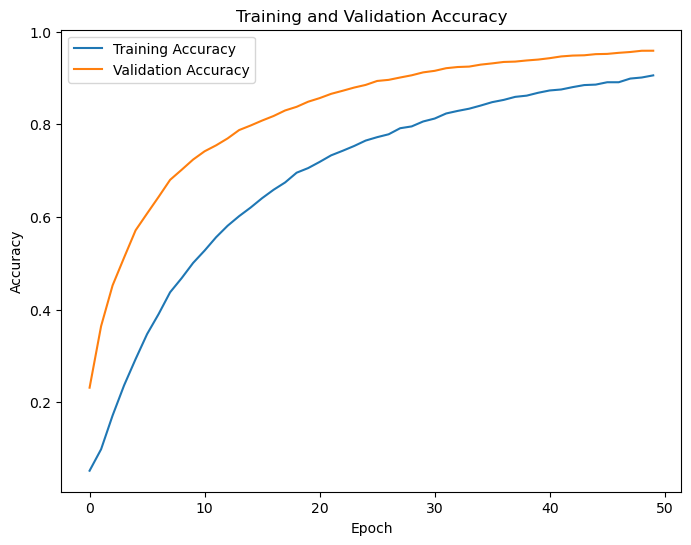

In [14]:
# Print training and validation accuracy
plt.figure(figsize=(8, 6))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

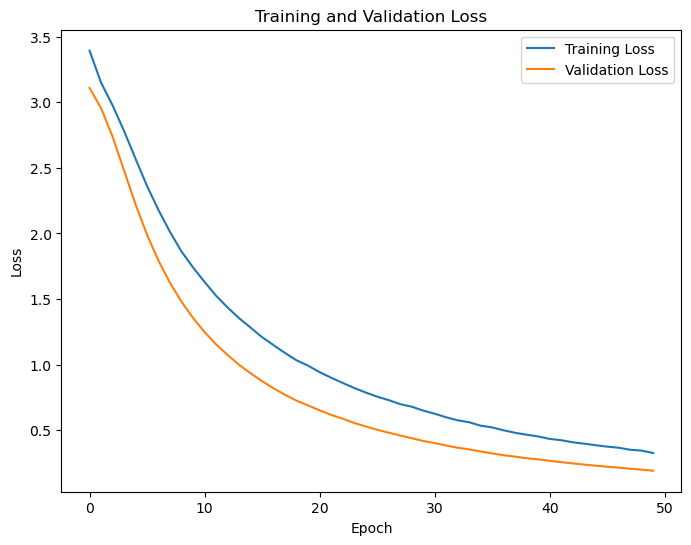

In [15]:
# Print training and validation loss
plt.figure(figsize=(8, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [16]:
# # Confusion Matrix
# fine_tuned_model = load_model("/kaggle/working/asl_vgg16_best_weights.h5")
# predictions = fine_tuned_model.predict(test_generator)

# # Get the true labels from the generator
# true_labels = test_generator.classes

# # Compute the confusion matrix using tf.math.confusion_matrix
# confusion_matrix = tf.math.confusion_matrix(
#         labels=true_labels,
#         predictions=predictions.argmax(axis=1),
#         num_classes=29)

# import seaborn as sns
# import matplotlib.pyplot as plt

# # Create Figure and Axes
# fig, ax = plt.subplots(figsize=(10, 8))

# # Create Confusion Matrix Heatmap
# sns.heatmap(confusion_matrix, annot=True, fmt="d", cmap="Blues", ax=ax)

# # Set Labels, Title, and Layout
# ax.set_xlabel('Predicted Labels')
# ax.set_ylabel('True Labels')
# ax.set_title('Confusion Matrix')
# plt.tight_layout()

# # Show the Plot
# plt.show()


7000/7000 [==============================] - 30s 4ms/step


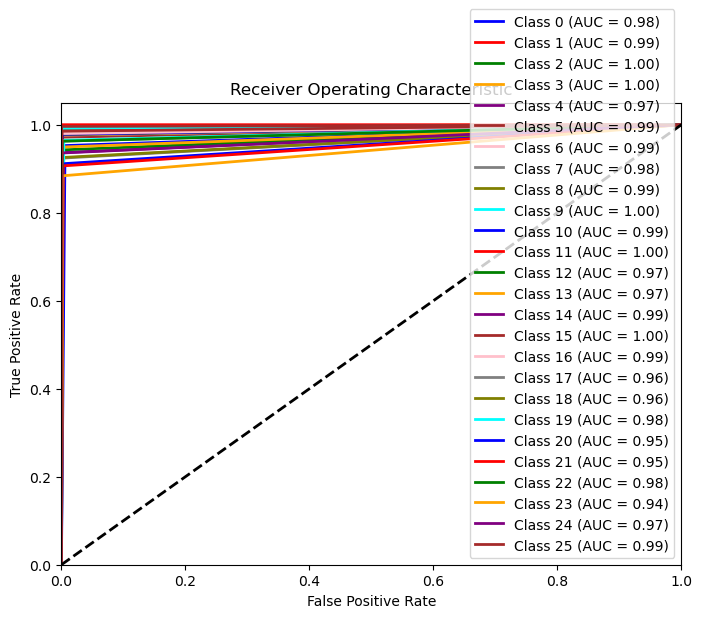

In [17]:
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.preprocessing import label_binarize
from itertools import cycle

# Compute and print ROC curve and AUC
y_pred_probs = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred_probs, axis=1)

y_true = test_generator.classes
y_true_binarized = label_binarize(y_true, classes=range(len(labels)))
y_pred_binarized = label_binarize(y_pred_classes, classes=range(len(labels)))

n_classes = len(labels)
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_true_binarized[:, i], y_pred_binarized[:, i])
    roc_auc[i] = roc_auc_score(y_true_binarized[:, i], y_pred_binarized[:, i])

colors = cycle(['blue', 'red', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan'])

plt.figure(figsize=(8, 6))
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label='Class {0} (AUC = {1:.2f})'.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


In [18]:
# Compute and print precision, recall, and F1-score
precision, recall, f1, _ = precision_recall_fscore_support(y_true, y_pred_classes, average='macro')
print("Precision: {:.2f}".format(precision))
print("Recall: {:.2f}".format(recall))
print("F1-Score: {:.2f}".format(f1))

Precision: 0.96
Recall: 0.96
F1-Score: 0.96


1/1 [==============================] - 0s 37ms/step


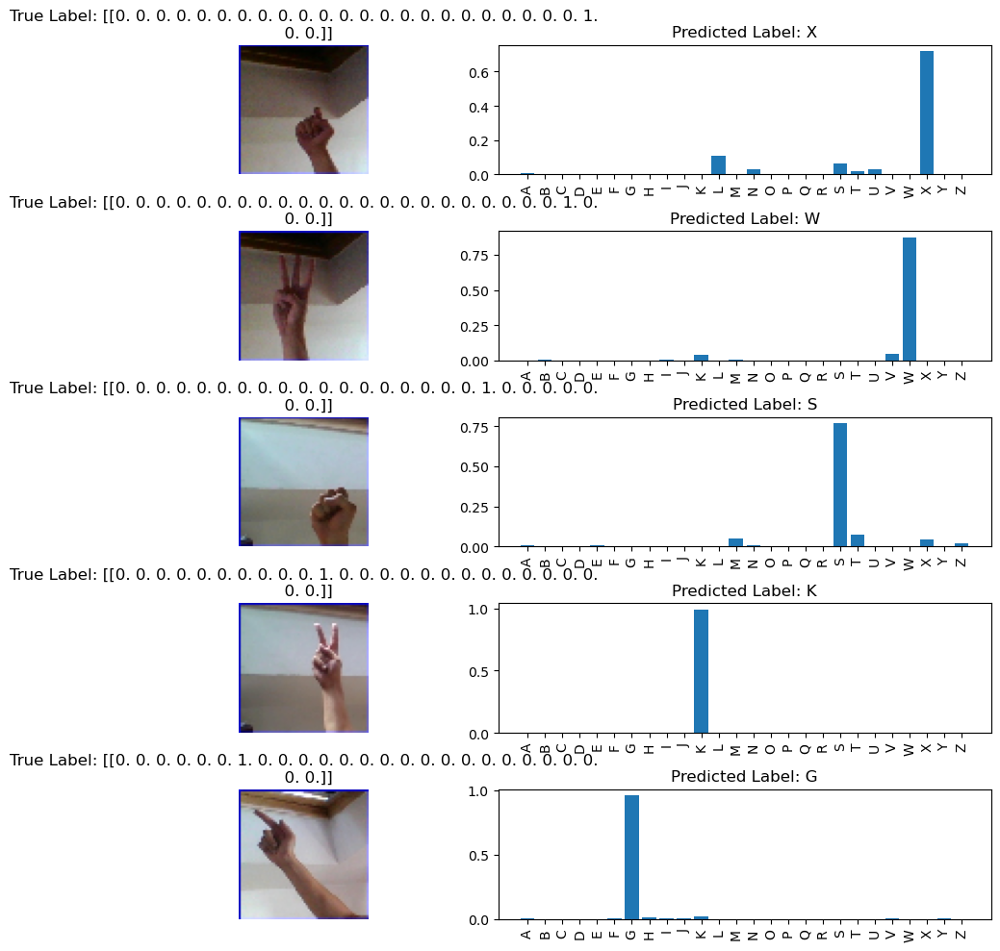

In [19]:
num_samples = 5
sample_indices = np.random.choice(range(len(test_generator)), size=num_samples, replace=False)

fig, axs = plt.subplots(num_samples, 2, figsize=(10, 10))
for i, index in enumerate(sample_indices):
    image, true_label = test_generator[index]
    image = np.squeeze(image)  # Remove extra dimension
    pred_probs = model.predict(np.expand_dims(image, axis=0))[0]
    predicted_label = labels[np.argmax(pred_probs)]
    axs[i, 0].imshow(image)
    axs[i, 0].axis('off')
    axs[i, 0].set_title('True Label: {}'.format(true_label))
    axs[i, 1].bar(range(len(labels)), pred_probs)  # Update the x-axis
    axs[i, 1].set_xticks(range(len(labels)))  # Update the x-axis
    axs[i, 1].set_xticklabels(labels, rotation='vertical')
    axs[i, 1].set_title('Predicted Label: {}'.format(predicted_label))
plt.tight_layout()
plt.show()


In [20]:
# from tensorflow.keras.preprocessing import image
# from tensorflow.keras.applications.vgg16 import preprocess_input

# # Load and preprocess the image
# uploaded_image_path = "/kaggle/input/asl-alphabet-test/Z/Z0002_test.jpg"  # Replace with the actual path of your image
# uploaded_image = image.load_img(uploaded_image_path, target_size=(64, 64))
# uploaded_image = image.img_to_array(uploaded_image)
# uploaded_image = preprocess_input(uploaded_image)
# uploaded_image = np.expand_dims(uploaded_image, axis=0)

# # Make predictions using the trained model
# prediction = model.predict(uploaded_image)
# predicted_label = labels[np.argmax(prediction)]

# # Display the predicted label
# print("Predicted Label:", predicted_label)

# # Plot the probability distribution
# probabilities = prediction.squeeze()
# plt.bar(labels, probabilities)
# plt.xlabel('Class')
# plt.ylabel('Probability')
# plt.xticks(rotation='vertical')
# plt.title('Probability Distribution')
# plt.show()


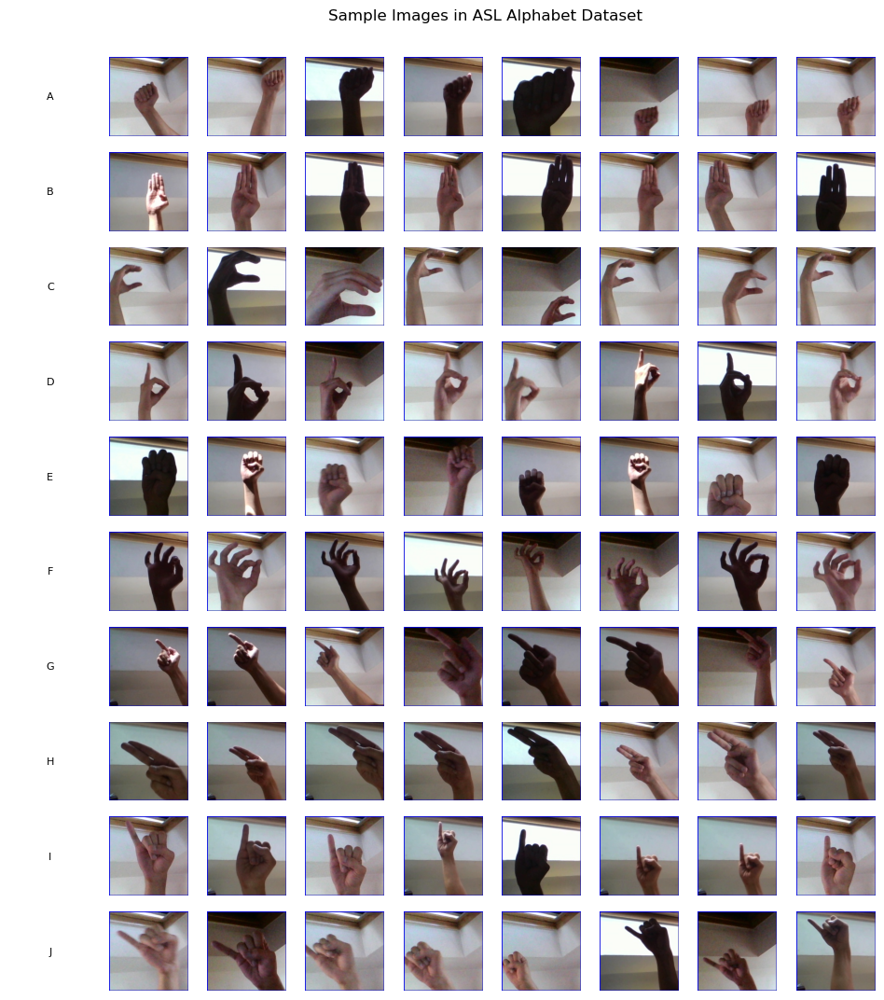

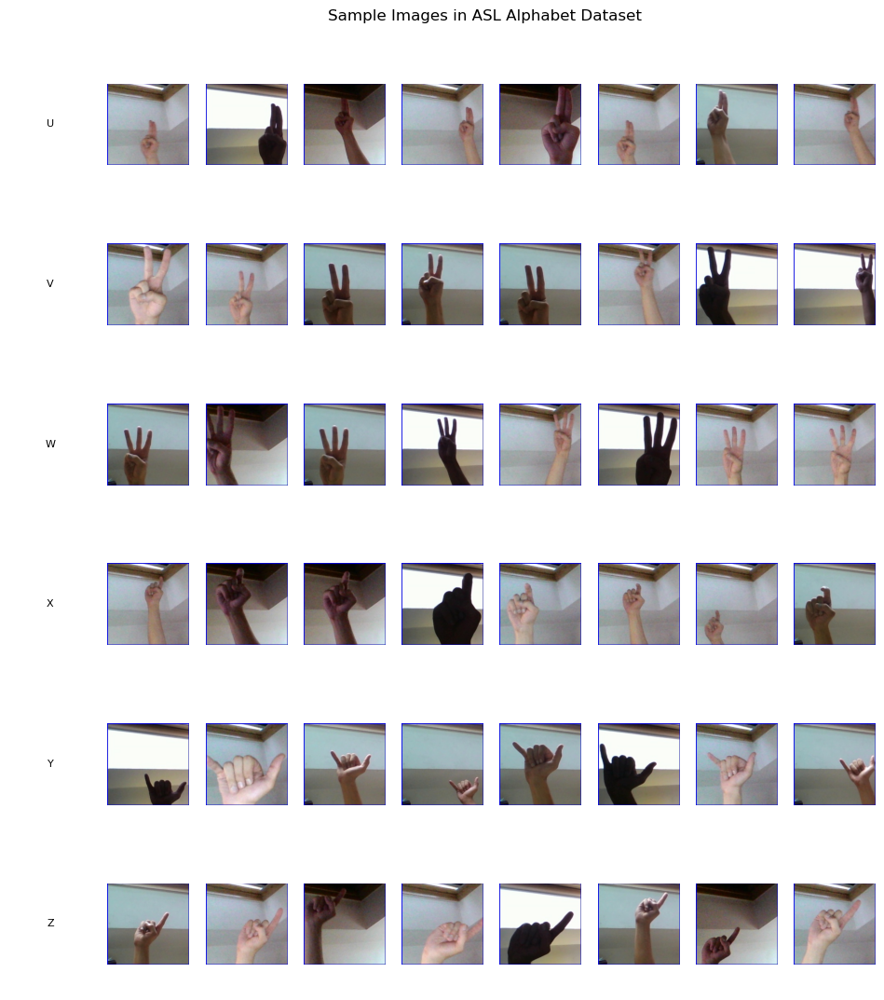

In [21]:
# Display sample images for the first 10 labels and labels from 20 onwards
sample_images(labels[:10])
sample_images(labels[20:])

7000/7000 [==============================] - 30s 4ms/step
Number of misclassified images: 279
Misclassified labels:
[ 2 17 20 13  7  0 10 15 17 20 14 12 18 25  5 23 21 22 13 12 23 18 13  0
  1 23  7 24 23 20 13 23 21 13 23 23  4  2 21 23  0 13 10  6 24 21 21 23
 24  4 13  4 20 23  6 14 22  4  8 19 18 16 20  1 24 18 19 22  0  7 12 21
 17  0 18 12 24 19 22 21 14  5  8 20 17 18 18 17 13 21  4 23 21 21  8 17
 23 20 24 18 20 17  5 16 17 12 17 18  5 24 20  4 17 18 23 23 20 20 17 23
 23 21 18 24 23 17 16 21 12  6 23  4 18 14  4 23 19  4 17 23 17 12  5 23
  1 21 24  4 23 12 21  0  6 25  8 18 18 21 20  7 22 12  8 21  7 20 21 16
 13 24  4 18 22 21 22 12 23 20 20  7 23 18 23 18 10  4  6  7 22  0 25  8
 17 24 20 16 23 17 25 24 10 22 20 23 20 20 21 18  0  9 20  4 20 12 17  7
 13  6 17  7 21  0 17 10 23 23 21  5 23 17  7 24 18 19 17  5 19  5  4 18
  0 19 17 18 12 23 13 24  9 17  7 13 17  0 13  4  4 22 23 12 24 20 19 17
 24 23  4 22 10 19 23 21  6 14  0  3 12 18 21]


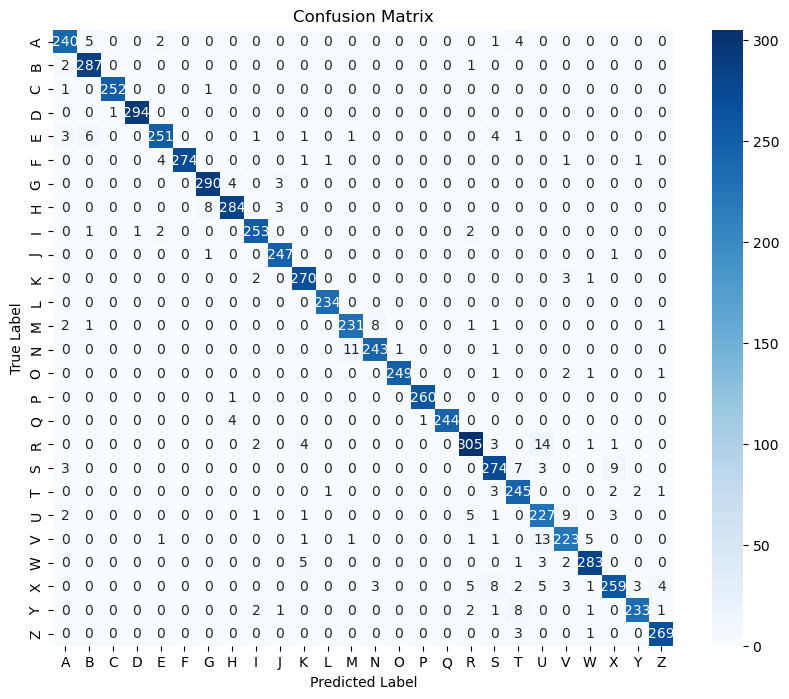

Classification Report:
              precision    recall  f1-score   support

           A       0.95      0.95      0.95       252
           B       0.96      0.99      0.97       290
           C       1.00      0.99      0.99       254
           D       1.00      1.00      1.00       295
           E       0.97      0.94      0.95       268
           F       1.00      0.97      0.99       282
           G       0.97      0.98      0.97       297
           H       0.97      0.96      0.97       295
           I       0.97      0.98      0.97       259
           J       0.97      0.99      0.98       249
           K       0.95      0.98      0.97       276
           L       0.99      1.00      1.00       234
           M       0.95      0.94      0.94       245
           N       0.96      0.95      0.95       256
           O       1.00      0.98      0.99       254
           P       1.00      1.00      1.00       261
           Q       1.00      0.98      0.99       249
    

In [22]:
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np

# Predict the labels for the test set
y_pred = model.predict(test_generator)
y_pred_labels = np.argmax(y_pred, axis=1)
true_labels = test_generator.classes

# Create a confusion matrix
cm = confusion_matrix(true_labels, y_pred_labels)

# Get the misclassified indices
misclassified_indices = np.where(y_pred_labels != true_labels)[0]

# Get the misclassified labels
misclassified_labels = np.array(test_generator.classes)[misclassified_indices]

# Count the number of misclassified images
num_misclassified = len(misclassified_indices)

print("Number of misclassified images:", num_misclassified)

# Show the misclassified labels
print("Misclassified labels:")
print(misclassified_labels)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=labels, yticklabels=labels)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# Classification Report
target_names = labels
print("Classification Report:")
print(classification_report(true_labels, y_pred_labels, target_names=target_names))


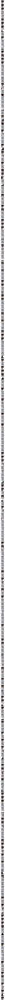

In [23]:
import numpy as np
import matplotlib.pyplot as plt

# Get the misclassified images and their predicted labels
misclassified_indices = np.where(y_pred_labels != true_labels)[0]
misclassified_labels = np.array(test_generator.classes)[misclassified_indices]
predicted_labels = np.array([labels[label_idx] for label_idx in y_pred_labels[misclassified_indices]])


# Function to plot misclassified images
def plot_misclassified_images(images, true_labels, predicted_labels):
    fig, axs = plt.subplots(len(images), 1, figsize=(8, 2*len(images)))
    for i, image in enumerate(images):
        axs[i].imshow(image)
        axs[i].axis('off')
        axs[i].set_title(f"True Label: {true_labels[i]}, Predicted Label: {predicted_labels[i]}")

    plt.tight_layout()
    plt.show()

# Get the misclassified images from the test generator
misclassified_images = [test_generator[i][0][0] for i in misclassified_indices]

# Plot the misclassified images and labels
plot_misclassified_images(misclassified_images, misclassified_labels, predicted_labels)


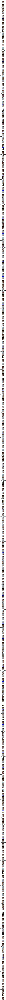

In [24]:
import numpy as np
import matplotlib.pyplot as plt

# Get the misclassified images and their predicted labels
misclassified_indices = np.where(y_pred_labels != true_labels)[0]
misclassified_labels = np.array(test_generator.classes)[misclassified_indices]
predicted_labels = np.array([labels[label_idx] for label_idx in y_pred_labels[misclassified_indices]])

# Function to plot misclassified images
def plot_misclassified_images(images, true_labels, predicted_labels):
    fig, axs = plt.subplots(len(images), 1, figsize=(8, 2*len(images)))
    for i, image in enumerate(images):
        true_label_idx = true_labels[i]
        true_label_name = labels[true_label_idx]
        
        axs[i].imshow(image)
        axs[i].axis('off')
        axs[i].set_title(f"True Label: {true_label_name} ({true_label_idx}), Predicted Label: {predicted_labels[i]}")

    plt.tight_layout()
    plt.show()

# Get the misclassified images from the test generator
misclassified_images = [test_generator[i][0][0] for i in misclassified_indices]

# Plot the misclassified images and labels
plot_misclassified_images(misclassified_images, misclassified_labels, predicted_labels)


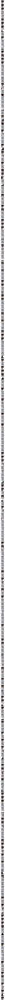

In [25]:
import numpy as np
import matplotlib.pyplot as plt

# Get the misclassified images and their predicted labels
misclassified_indices = np.where(y_pred_labels != true_labels)[0]
misclassified_labels = np.array(test_generator.classes)[misclassified_indices]
predicted_labels = np.array([labels[label_idx] for label_idx in y_pred_labels[misclassified_indices]])

# Function to plot misclassified images
def plot_misclassified_images(images, true_labels, predicted_labels):
    fig, axs = plt.subplots(len(images), 1, figsize=(8, 2*len(images)))
    for i, image in enumerate(images):
        true_label_name = true_labels[i]
        predicted_label_name = predicted_labels[i]
        
        axs[i].imshow(image)
        axs[i].axis('off')
        axs[i].set_title(f"True Label: {true_label_name}, Predicted Label: {predicted_label_name}")

    plt.tight_layout()
    plt.show()

# Get the misclassified images from the test generator
misclassified_images = [test_generator[i][0][0] for i in misclassified_indices]

# Plot the misclassified images and labels
plot_misclassified_images(misclassified_images, misclassified_labels, predicted_labels)


In [26]:
# Save the trained model
model.save('asl_model_vgg16_50epochs_onasl-alphabet.h5')

# Print a message indicating the model is saved
print("Model saved successfully.")


Model saved successfully.


In [27]:
# import numpy as np
# import matplotlib.pyplot as plt
# import seaborn as sns
# from sklearn.metrics import confusion_matrix

# # Get the true and predicted labels for the test set
# y_true = test_data['label']
# y_pred_labels = np.argmax(model.predict(test_generator), axis=1)

# # Create a binary mask for labels 'A' and 'S'
# mask_A = (y_true == 'A')
# mask_S = (y_true == 'S')

# # Filter the true and predicted labels for labels 'A' and 'S'
# y_true_A = y_true[mask_A]
# y_pred_A = y_pred_labels[mask_A]
# y_true_S = y_true[mask_S]
# y_pred_S = y_pred_labels[mask_S]

# # Create the list of all unique labels
# labels = np.unique(y_true)

# # Convert the string labels to numeric class indices
# label_to_numeric = {label: i for i, label in enumerate(labels)}
# y_true_A = np.array([label_to_numeric[label] for label in y_true_A])

# # Add predicted labels to the label_to_numeric dictionary and convert y_pred_A to numeric format
# for label in np.unique(y_pred_A):
#     if label not in label_to_numeric:
#         label_to_numeric[label] = len(label_to_numeric)
# y_pred_A = np.array([label_to_numeric[label] for label in y_pred_A])

# # Convert y_true_S to numeric format
# y_true_S = np.array([label_to_numeric[label] for label in y_true_S])

# # Add predicted labels to the label_to_numeric dictionary and convert y_pred_S to numeric format
# for label in np.unique(y_pred_S):
#     if label not in label_to_numeric:
#         label_to_numeric[label] = len(label_to_numeric)
# y_pred_S = np.array([label_to_numeric[label] for label in y_pred_S])

# # Create the confusion matrix for labels 'A' and 'S'
# confusion_matrix_A = confusion_matrix(y_true_A, y_pred_A)
# confusion_matrix_S = confusion_matrix(y_true_S, y_pred_S)

# # Plot the confusion matrix for label 'A'
# plt.figure(figsize=(5, 5))
# sns.heatmap(confusion_matrix_A, annot=True, fmt="d", cmap="Blues", xticklabels=labels, yticklabels=labels)
# plt.xlabel("Predicted Label")
# plt.ylabel("True Label")
# plt.title("Confusion Matrix for Label 'A'")
# plt.show()

# # Plot the confusion matrix for label 'S'
# plt.figure(figsize=(5, 5))
# sns.heatmap(confusion_matrix_S, annot=True, fmt="d", cmap="Blues", xticklabels=labels, yticklabels=labels)
# plt.xlabel("Predicted Label")
# plt.ylabel("True Label")
# plt.title("Confusion Matrix for Label 'S'")
# plt.show()


7000/7000 [==============================] - 30s 4ms/step


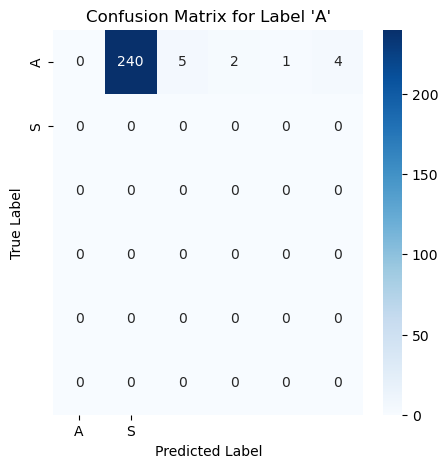

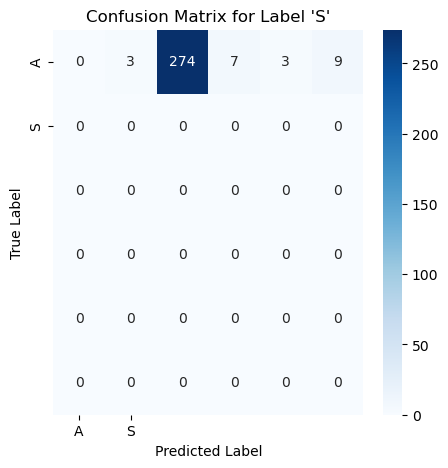

In [28]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Get the true and predicted labels for the test set
y_true = test_data['label']
y_pred_labels = np.argmax(model.predict(test_generator), axis=1)

# Create a binary mask for labels 'A' and 'S'
mask_A = (y_true == 'A')
mask_S = (y_true == 'S')

# Filter the true and predicted labels for labels 'A' and 'S'
y_true_A = y_true[mask_A]
y_pred_A = y_pred_labels[mask_A]
y_true_S = y_true[mask_S]
y_pred_S = y_pred_labels[mask_S]

# Create the list of labels 'A' and 'S' only
labels = ['A', 'S']

# Convert the string labels to numeric class indices
label_to_numeric = {label: i for i, label in enumerate(labels)}
y_true_A = np.array([label_to_numeric[label] for label in y_true_A])

# Add predicted labels to the label_to_numeric dictionary and convert y_pred_A to numeric format
for label in np.unique(y_pred_A):
    if label not in label_to_numeric:
        label_to_numeric[label] = len(label_to_numeric)
y_pred_A = np.array([label_to_numeric[label] for label in y_pred_A])

# Convert y_true_S to numeric format
y_true_S = np.array([label_to_numeric[label] for label in y_true_S])

# Add predicted labels to the label_to_numeric dictionary and convert y_pred_S to numeric format
for label in np.unique(y_pred_S):
    if label not in label_to_numeric:
        label_to_numeric[label] = len(label_to_numeric)
y_pred_S = np.array([label_to_numeric[label] for label in y_pred_S])

# Create the confusion matrix for labels 'A' and 'S'
confusion_matrix_A = confusion_matrix(y_true_A, y_pred_A)
confusion_matrix_S = confusion_matrix(y_true_S, y_pred_S)

# Plot the confusion matrix for label 'A'
plt.figure(figsize=(5, 5))
sns.heatmap(confusion_matrix_A, annot=True, fmt="d", cmap="Blues", xticklabels=labels, yticklabels=labels)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix for Label 'A'")
plt.show()

# Plot the confusion matrix for label 'S'
plt.figure(figsize=(5, 5))
sns.heatmap(confusion_matrix_S, annot=True, fmt="d", cmap="Blues", xticklabels=labels, yticklabels=labels)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix for Label 'S'")
plt.show()


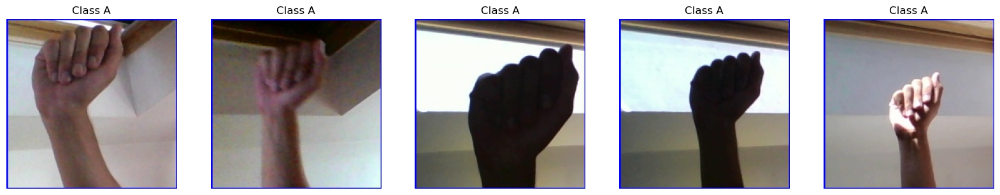

In [29]:
import random

# Filter the data to include only samples from class 'A'
class_A_data = data_train[data_train['label'] == 'A']

# Set the number of random samples you want to select from class 'A'
num_random_samples = 5

# Randomly select samples from class 'A'
random_samples_class_A = random.sample(class_A_data['image_path'].tolist(), num_random_samples)

# Display the randomly selected samples
fig, axs = plt.subplots(1, num_random_samples, figsize=(20, 4))
for i, image_path in enumerate(random_samples_class_A):
    image = Image.open(image_path)
    axs[i].imshow(image)
    axs[i].axis('off')
    axs[i].set_title('Class A')
plt.show()


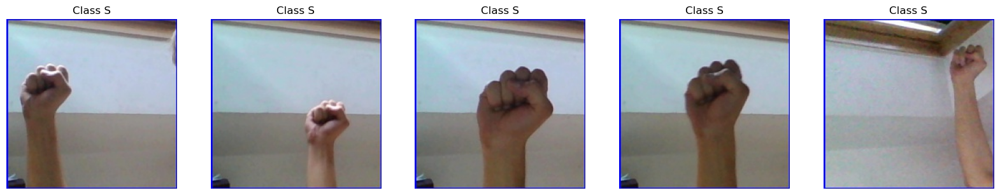

In [30]:
import random

# Filter the data to include only samples from class 'A'
class_A_data = data_train[data_train['label'] == 'S']

# Set the number of random samples you want to select from class 'A'
num_random_samples = 5

# Randomly select samples from class 'A'
random_samples_class_A = random.sample(class_A_data['image_path'].tolist(), num_random_samples)

# Display the randomly selected samples
fig, axs = plt.subplots(1, num_random_samples, figsize=(20, 4))
for i, image_path in enumerate(random_samples_class_A):
    image = Image.open(image_path)
    axs[i].imshow(image)
    axs[i].axis('off')
    axs[i].set_title('Class S')
plt.show()


In [31]:
# # Assuming you have y_pred_probs, labels, misclassified_images, misclassified_labels, and predicted_labels
# label_s = "Label S"  # Replace "Label S" with the actual name of Label S
# label_a = "Label A"  # Replace "Label A" with the actual name of Label A

# plot_misclassified_images_between_labels(misclassified_images, misclassified_labels, predicted_labels, labels, label_s, label_a)


7000/7000 [==============================] - 30s 4ms/step


Text(0, 0.5, 'Precision')

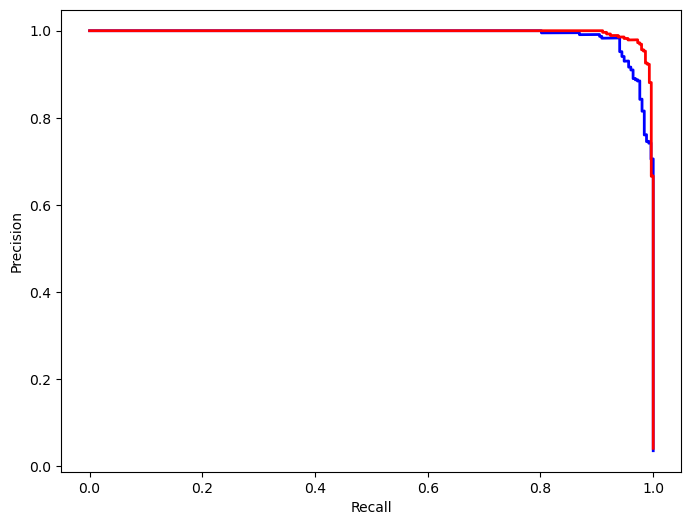

In [32]:
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier

# Binarize the true labels for multiclass problems
y_true_bin = label_binarize(test_generator.classes, classes=range(len(labels)))

# Create the OneVsRestClassifier
ovr = OneVsRestClassifier(model)

# Predict the probabilities for each class using the underlying model (VGG16)
y_pred_probs = model.predict(test_generator)

# Calculate precision-recall values for each class
precision = dict()
recall = dict()
average_precision = dict()

for i in range(len(labels)):
    precision[i], recall[i], _ = precision_recall_curve(y_true_bin[:, i], y_pred_probs[:, i])
    average_precision[i] = average_precision_score(y_true_bin[:, i], y_pred_probs[:, i])

# Plot Precision-Recall curves for each class
plt.figure(figsize=(8, 6))
colors = cycle(['blue', 'red', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan'])

for i, color in zip(range(len(labels)), colors):
    plt.plot(recall[i], precision[i], color=color, lw=2, label='Class {} (AP = {:.2f})'.format(labels[i], average_precision[i]))

plt.xlabel('Recall')
plt.ylabel('Precision')
